In [2]:
import pandas as pd
import numpy as np
import mma
import skimage
import matplotlib.pyplot as plt
import matplotlib.animation as anm
plt.rcParams['animation.ffmpeg_path'] = '/home/jparkin/anaconda3/envs/conda_jpdev/bin/ffmpeg'
import scipy
import time

from IPython.display import HTML
from matplotlib.lines import Line2D
import matplotlib.colors as mpl_colors
import seaborn as sns

mpl_named_colors = ['gray', 'g', 'y', 'r', 'k', 'c']

In [3]:
import os
os.environ["OMP_NUM_THREADS"] = '4'

In [4]:
with open('./txt_files/unique_good_dirs_nodatadirs.txt', 'r') as f:
    exp_dirs = f.read().splitlines()
i = 0

In [5]:
def plot_positions(cor_pos_df, out_fn=None):
    plt.figure(figsize=(18,18))
    n_pads = len(cor_pos_df.groupby('pad'))
    pad_inds = np.unique(cor_pos_df.pad.values)
    colors = sns.color_palette('Set1', n_colors=n_pads)
    colors_dict = dict(zip(pad_inds, colors))
    for p_i in cor_pos_df.index:
        point_color = colors_dict[np.int(cor_pos_df.loc[p_i,"pad"])]
        plt.plot(np.float(cor_pos_df.x[p_i]),
                 -np.float(cor_pos_df.y[p_i]),
                 '.',
                 label=cor_pos_df.pad[p_i],
                 ms=20,
                 c=point_color)
        plt.text(np.float(cor_pos_df.x[p_i]),
                 -np.float(cor_pos_df.y[p_i]),
                 '{}'.format(cor_pos_df.loc[p_i, 'label']),
                 fontsize=14,
                 rotation=15)
    handles = [Line2D([0],[0],color=colors[xx],marker='o',label=xx) for xx in np.arange(n_pads)]
    plt.legend(handles=handles)
    plt.gca().set_aspect('equal')
#     plt.savefig(out_fn)
#     plt.close('all')


In [4]:
def write_movie_no_bg(out_fn, flip, xlims, pad_ind, cross_df, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
    # Get movie metadata
    if cross_df is None:
        cross_df = pd.DataFrame(columns=['pad','frame','channel'])
    cross_gb = cross_df.groupby(['pad','frame','channel'])
    sub_fdf = files_df.loc[files_df.pad==pad_ind,:]
    n_chan, chan_ind_list, chan_names, im_width, im_height = mma.get_exp_summary_from_fn(files_df.fn.values[0])
    n_frames = files_df.frame.max()+1
    frame_vec = np.sort(np.unique(files_df.frame.values))
    pixel_size = pixel_size * scale
    h, w = im_height//scale, im_width//scale
    rh, rw = skimage.transform.rotate(np.ones((h,w)), rotation, resize=True).shape
    uint_max = 65535
    # Setup plotting variables
    plt.close('all')
    pad_df = cor_pos_df.loc[cor_pos_df.pad==pad_ind,:]
    pos_list = np.unique(pad_df.index.values)
    xlims = np.array([pad_df.x.min(), pad_df.x.max()])/pixel_size + rw*np.array([0,1])
    ylims = np.array([pad_df.y.min(), pad_df.y.max()])/pixel_size + rh*np.array([0,1])
    rel_mins = np.concatenate([[xlims], [ylims]],axis=0).astype(np.int)
    pad_h = np.int(np.ceil(np.diff(ylims)))
    pad_w = np.int(np.ceil(np.diff(xlims)))
    fig_h, fig_w = np.array([pad_h, pad_w])/(100/scale)
    while fig_h > 1e5 or fig_w > 1e5:
        fig_h, fig_w = np.array([fig_h, fig_w])/5
    # Define helper functions
    def load_img(frame, pos, channel, rotation=rotation, scale=scale, sigma=3, files_df=files_df):
        frame_bool = files_df.frame==frame
        pos_bool = files_df.pos==pos
        chan_bool = files_df.channel == channel
        indx_bool = (frame_bool)&(pos_bool)&(chan_bool)
        if sum(indx_bool) < 1:
            error_msg = 'Image not found when printing {}: pad:{} frame:{} pos:{} channel:{}'
            error_msg = error_msg.format(out_fn, pad_ind, frame, pos, channel)
            print(error_msg)
            return skimage.transform.rotate(np.zeros((rh,rw)),rotation,resize=True)
        fn = files_df.loc[indx_bool,'fn'].values[0]
        try:
            img = skimage.filters.gaussian(skimage.io.imread(fn).astype(np.float), sigma)
        except Exception as error:
            print('import img error {}'.format(fn))
            raise error
        img = skimage.transform.downscale_local_mean(img, (scale, scale))
        return skimage.transform.rotate(img, rotation, resize=True)

    pad_arr = np.zeros((pad_h, pad_w, n_chan))
    chan_vec = np.array(chan_ind_list)
    pos_lims = (pad_df[['x','y']]/pixel_size).astype(np.int)
    count_arr = np.zeros((pad_h, pad_w))
    img_arr = skimage.transform.rotate(np.ones((h,w)),rotation,resize=True)
    for pos in pos_list:
        x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
        count_arr[y0:y0+rh,x0:x0+rw] += img_arr
    uncovered_arr = count_arr<=0
    covered_arr = count_arr>0
    count_arr[count_arr<=0] = 1

    def get_frame_arr(frame_ind):
        im_arr = np.zeros((rh,rw))
        bg_arr = np.zeros((rh,rw))
        # get background image
        bg_pos_list = [4,5,6,21,22]
        n_bg = len(bg_pos_list)
        for chan_i, channel in enumerate(chan_vec):
            for pos in pos_list:
                x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
                im_arr[:] = 0
                im_arr += load_img(frame_ind, pos, channel)
                bg_arr[:] = 0
                bg_arr += load_img(0, pos, channel, sigma=30)
                pad_arr[y0:y0+rh,x0:x0+rw,chan_i] += im_arr - bg_arr
            pad_arr[:,:,chan_i] /= count_arr
    
    def animate(i):
        img_arr = np.zeros((pad_h, pad_w, 3))
        pad_arr[:] = 0
        get_frame_arr(i)
        # For no-bg gifs, normalize relative to the middle frame.
        # Use contrast-stretching approach, where the bounds are the middle 90 percentile
        norm_vec = []
        for chan_ind in np.arange(n_chan):
            frame_vals = pad_arr[:,:,chan_ind][covered_arr].flatten()
            frame_vals = np.sort(frame_vals)
            frame_n = len(frame_vals)
            ind_min, ind_max = np.array([0.05*frame_n, 0.95*frame_n],dtype=np.int)
            vmin, vmax = frame_vals[ind_min], frame_vals[ind_max]
            vmin = np.max([0, vmin])
            vmax = np.max([vmax+vmin,vmin*2])
            norm_fn = mpl_colors.Normalize(vmin, vmax, clip=True)
            norm_vec.append(norm_fn)
        for chan_ind, chan_slot in enumerate(chan_vec):
            norm = norm_vec[chan_ind]
            chan_arr = pad_arr[:,:,chan_ind:chan_ind+1]
            color_vec = mpl_colors.to_rgb(mpl_named_colors[chan_slot])
            img_arr += np.concatenate([norm(chan_arr)*color_val for color_val in color_vec],axis=2)
            key = (pad, i, chan_slot)
            if key in cross_gb.groups.keys():
                segs = vl.get_segments()
                xval = cross_gb.get_group(key).x.mean()/pixel_size
                if flip==1:
                    xval = (pad_w-xlims_vec[pad][1])+xval
                else:
                    xval = xval+xlims_vec[pad][0]
                segs[chan_ind][:,0]=xval
                segs = vl.set_segments(segs)
        if flip==1:
            im.set_array(img_arr[:,::-1,:])
        else:
            im.set_array(img_arr)
        return im, vl
    
    def init():
        out = animate(0)
        return out

    fig, ax = plt.subplots(1, 1, figsize=(fig_w,fig_h+1.2))
    img_arr = np.zeros((pad_h, pad_w, 3))
    vl_colors = [mpl_colors.to_rgb(mpl_named_colors[chan_slot]) for chan_slot in chan_ind_list]
    vl = ax.vlines([0]*n_chan,
                   [0]*n_chan,
                   [pad_h]*n_chan,
                   colors=vl_colors,
                   lw=[10]*n_chan, animated=True)
    
    im = ax.imshow(img_arr.copy(), interpolation='none',animated=True)
    xticks = np.arange(0,pad_w,500/pixel_size)
    xlabs = ['{:0.2f}'.format(xx) for xx in xticks*pixel_size]
    ax.set_xticks(xticks)
    ax.set_xticklabels(xlabs)
    ax.set_yticks([])
    ax.set_xlim([0,pad_w])
    ax.set_title("Pad {}".format(pad_ind))

    fig.tight_layout()

    def init():
        out = animate(0)
        return out
    
    init()
    anim = anm.FuncAnimation(fig, animate, interval=200, frames=frame_vec, init_func=init)
    plt.close('all')
    anim.save(out_fn, dpi=80, fps=1, writer='pillow')
#     return anim
#     return fig, pad_arr
#     fig.savefig(out_fn)
#     plt.close('all')


In [5]:
def write_frame_no_bg(frame_ind, flip, xlims, pad_ind, cross_df, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
    # Get movie metadata
    if cross_df is None:
        cross_df = pd.DataFrame(columns=['pad','frame','channel'])
    cross_gb = cross_df.groupby(['pad','frame','channel'])
    sub_fdf = files_df.loc[files_df.pad==pad_ind,:]
    n_chan, chan_ind_list, chan_names, im_width, im_height = mma.get_exp_summary_from_fn(files_df.fn.values[0])
    n_frames = files_df.frame.max()+1
    frame_vec = np.sort(np.unique(files_df.frame.values))
    pixel_size = pixel_size * scale
    h, w = im_height//scale, im_width//scale
    rh, rw = skimage.transform.rotate(np.ones((h,w)), rotation, resize=True).shape
    uint_max = 65535
    # Setup plotting variables
    plt.close('all')
    pad_df = cor_pos_df.loc[cor_pos_df.pad==pad_ind,:]
    pos_list = np.unique(pad_df.index.values)
    xlims = np.array([pad_df.x.min(), pad_df.x.max()])/pixel_size + rw*np.array([0,1])
    ylims = np.array([pad_df.y.min(), pad_df.y.max()])/pixel_size + rh*np.array([0,1])
    rel_mins = np.concatenate([[xlims], [ylims]],axis=0).astype(np.int)
    pad_h = np.int(np.ceil(np.diff(ylims)))
    pad_w = np.int(np.ceil(np.diff(xlims)))
    fig_h, fig_w = np.array([pad_h, pad_w])/(100/scale)
    while fig_h > 1e5 or fig_w > 1e5:
        fig_h, fig_w = np.array([fig_h, fig_w])/5
    # Define helper functions
    def load_img(frame, pos, channel, rotation=rotation, scale=scale, sigma=3, files_df=files_df):
        frame_bool = files_df.frame==frame
        pos_bool = files_df.pos==pos
        chan_bool = files_df.channel == channel
        indx_bool = (frame_bool)&(pos_bool)&(chan_bool)
        if sum(indx_bool) < 1:
            error_msg = 'Image not found when printing {}: pad:{} frame:{} pos:{} channel:{}'
            error_msg = error_msg.format(out_fn, pad_ind, frame, pos, channel)
            print(error_msg)
            return skimage.transform.rotate(np.zeros((rh,rw)),rotation,resize=True)
        fn = files_df.loc[indx_bool,'fn'].values[0]
        try:
            img = skimage.filters.gaussian(skimage.io.imread(fn).astype(np.float), sigma)
        except Exception as error:
            print('import img error {}'.format(fn))
            raise error
        img = skimage.transform.downscale_local_mean(img, (scale, scale))
        return skimage.transform.rotate(img, rotation, resize=True)

    pad_arr = np.zeros((pad_h, pad_w, n_chan))
    chan_vec = np.array(chan_ind_list)
    pos_lims = (pad_df[['x','y']]/pixel_size).astype(np.int)
    count_arr = np.zeros((pad_h, pad_w))
    img_arr = skimage.transform.rotate(np.ones((h,w)),rotation,resize=True)
    for pos in pos_list:
        x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
        count_arr[y0:y0+rh,x0:x0+rw] += img_arr
    uncovered_arr = count_arr<=0
    covered_arr = count_arr>0
    count_arr[count_arr<=0] = 1

    def get_frame_arr(frame_ind):
        im_arr = np.zeros((rh,rw))
        bg_arr = np.zeros((rh,rw))
        # get background image
        bg_pos_list = [4,5,6,21,22]
        n_bg = len(bg_pos_list)
        for chan_i, channel in enumerate(chan_vec):
            for pos in pos_list:
                x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
                im_arr[:] = 0
                im_arr += load_img(frame_ind, pos, channel)
                bg_arr[:] = 0
                bg_arr += load_img(0, pos, channel, sigma=30)
                pad_arr[y0:y0+rh,x0:x0+rw,chan_i] += im_arr - bg_arr
            pad_arr[:,:,chan_i] /= count_arr
            
    def animate(i):
        img_arr = np.zeros((pad_h, pad_w, 3))
        pad_arr[:] = 0
        get_frame_arr(i)
        # For no-bg gifs, normalize relative to the middle frame.
        # Use contrast-stretching approach, where the bounds are the middle 90 percentile
        norm_vec = []
        for chan_ind in np.arange(n_chan):
            frame_vals = pad_arr[:,:,chan_ind][covered_arr].flatten()
            frame_vals = np.sort(frame_vals)
            frame_n = len(frame_vals)
            ind_min, ind_max = np.array([0.05*frame_n, 0.95*frame_n],dtype=np.int)
            vmin, vmax = frame_vals[ind_min], frame_vals[ind_max]
            vmin = np.max([0, vmin])
            vmax = np.max([vmax+vmin,vmin*2])
            norm_fn = mpl_colors.Normalize(vmin, vmax, clip=True)
            norm_vec.append(norm_fn)
        for chan_ind, chan_slot in enumerate(chan_vec):
            norm = norm_vec[chan_ind]
            chan_arr = pad_arr[:,:,chan_ind:chan_ind+1]
            color_vec = mpl_colors.to_rgb(mpl_named_colors[chan_slot])
            img_arr += np.concatenate([norm(chan_arr)*color_val for color_val in color_vec],axis=2)
            key = (pad, i, chan_slot)
            if key in cross_gb.groups.keys():
                segs = vl.get_segments()
                xval = cross_gb.get_group(key).x.mean()/pixel_size
                if flip==1:
                    xval = (pad_w-xlims_vec[pad][1])+xval
                else:
                    xval = xval+xlims_vec[pad][0]
                segs[chan_ind][:,0]=xval
                segs = vl.set_segments(segs)
        if flip==1:
            im.set_array(img_arr[:,::-1,:])
        else:
            im.set_array(img_arr)
        return im, vl
    
    def init():
        out = animate(0)
        return out

    fig, ax = plt.subplots(1, 1, figsize=(fig_w,fig_h+1.2))
    img_arr = np.zeros((pad_h, pad_w, 3))
    vl_colors = [mpl_colors.to_rgb(mpl_named_colors[chan_slot]) for chan_slot in chan_ind_list]
    vl = ax.vlines([0]*n_chan,
                   [0]*n_chan,
                   [pad_h]*n_chan,
                   colors=vl_colors,
                   lw=[10]*n_chan, animated=True)
    
    im = ax.imshow(img_arr.copy(), interpolation='none',animated=True)
    #     cbar = fig.colorbar(im, ax=ax, ticks=[vmin, vmax])
    xticks = np.arange(0,pad_w,500/pixel_size)
    xlabs = ['{:0.2f}'.format(xx) for xx in xticks*pixel_size]
    ax.set_xticks(xticks)
    ax.set_xticklabels(xlabs)
    ax.set_yticks([])
    ax.set_xlim([0,pad_w])
    ax.set_title("Pad {}".format(pad_ind))

    fig.tight_layout()
    init()
    animate(frame_ind)
    return fig
#     anim = anm.FuncAnimation(fig, animate, interval=200, frames=frame_vec)
#     plt.close('all')
#     anim.save(out_fn, dpi=80, fps=1, writer='pillow')
#     return anim
#     return fig, pad_arr
#     fig.savefig(out_fn)
#     plt.close('all')


In [6]:
def write_frame_w_bg(frame_ind, flip, xlims, pad_ind, cross_df, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
    # Get movie metadata
    if cross_df is None:
        cross_df = pd.DataFrame(columns=['pad','frame','channel'])
    cross_gb = cross_df.groupby(['pad','frame','channel'])
    sub_fdf = files_df.loc[files_df.pad==pad_ind,:]
    n_chan, chan_ind_list, chan_names, im_width, im_height = mma.get_exp_summary_from_fn(files_df.fn.values[0])
    n_frames = files_df.frame.max()+1
    frame_vec = np.sort(np.unique(files_df.frame.values))
    pixel_size = pixel_size * scale
    h, w = im_height//scale, im_width//scale
    rh, rw = skimage.transform.rotate(np.ones((h,w)), rotation, resize=True).shape
    uint_max = 65535
    # Setup plotting variables
    plt.close('all')
    pad_df = cor_pos_df.loc[cor_pos_df.pad==pad_ind,:]
    pos_list = np.unique(pad_df.index.values)
    xlims = np.array([pad_df.x.min(), pad_df.x.max()])/pixel_size + rw*np.array([0,1])
    ylims = np.array([pad_df.y.min(), pad_df.y.max()])/pixel_size + rh*np.array([0,1])
    rel_mins = np.concatenate([[xlims], [ylims]],axis=0).astype(np.int)
    pad_h = np.int(np.ceil(np.diff(ylims)))
    pad_w = np.int(np.ceil(np.diff(xlims)))
    fig_h, fig_w = np.array([pad_h, pad_w])/(100/scale)
    while fig_h > 1e5 or fig_w > 1e5:
        fig_h, fig_w = np.array([fig_h, fig_w])/5
    # Define helper functions
    def load_img(frame, pos, channel, rotation=rotation, scale=scale, sigma=3, files_df=files_df):
        frame_bool = files_df.frame==frame
        pos_bool = files_df.pos==pos
        chan_bool = files_df.channel == channel
        indx_bool = (frame_bool)&(pos_bool)&(chan_bool)
        if sum(indx_bool) < 1:
            error_msg = 'Image not found when printing {}: pad:{} frame:{} pos:{} channel:{}'
            error_msg = error_msg.format(out_fn, pad_ind, frame, pos, channel)
            print(error_msg)
            return skimage.transform.rotate(np.zeros((rh,rw)),rotation,resize=True)
        fn = files_df.loc[indx_bool,'fn'].values[0]
        try:
            img = skimage.filters.gaussian(skimage.io.imread(fn).astype(np.float), sigma)
        except Exception as error:
            print('import img error {}'.format(fn))
            raise error
        img = skimage.transform.downscale_local_mean(img, (scale, scale))
        return skimage.transform.rotate(img, rotation, resize=True)
    
    def load_img_initsub(frame, pos, channel, rotation=rotation, scale=scale, sigma=3, files_df=files_df):
        im = load_img(frame, pos, channel, rotation, scale, sigma, files_df)
        bg_im = load_img(0, pos, channel, rotation, scale, sigma, files_df)
        return im-bg_im

    pad_arr = np.zeros((pad_h, pad_w, n_chan))
    chan_vec = np.array(chan_ind_list)
    pos_lims = (pad_df[['x','y']]/pixel_size).astype(np.int)
    count_arr = np.zeros((pad_h, pad_w))
    img_arr = skimage.transform.rotate(np.ones((h,w)),rotation,resize=True)
    for pos in pos_list:
        x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
        count_arr[y0:y0+rh,x0:x0+rw] += img_arr
    uncovered_arr = count_arr<=0
    covered_arr = count_arr>0
    count_arr[count_arr<=0] = 1

    def get_frame_arr(frame_ind):
        im_arr = np.zeros((rh,rw))
        bg_arr = np.zeros((rh,rw))
        # get background image
        bg_pos_list = [141,144,147,150,153]
        n_bg = len(bg_pos_list)
        for chan_i, channel in enumerate(chan_vec):
            bg_arr[:] = 0
            for bgpos in bg_pos_list:
                bg_arr += load_img_initsub(frame_ind, bgpos, channel, sigma=30)/n_bg
            for pos in pos_list:
                x0, y0 = (pos_lims.loc[pos,:].values - rel_mins[:,0]).astype(np.int)
                im_arr[:] = 0
                im_arr += load_img_initsub(frame_ind, pos, channel)
                pad_arr[y0:y0+rh,x0:x0+rw,chan_i] += im_arr - bg_arr
            pad_arr[:,:,chan_i] /= count_arr
            
    def animate(i):
        img_arr = np.zeros((pad_h, pad_w, 3))
        pad_arr[:] = 0
        get_frame_arr(i)
        # For no-bg gifs, normalize relative to the middle frame.
        # Use contrast-stretching approach, where the bounds are the middle 90 percentile
        norm_vec = []
        for chan_ind in np.arange(n_chan):
            frame_vals = pad_arr[:,:,chan_ind][covered_arr].flatten()
            frame_vals = np.sort(frame_vals)
            frame_n = len(frame_vals)
            ind_min, ind_max = np.array([0.05*frame_n, 0.95*frame_n],dtype=np.int)
            vmin, vmax = frame_vals[ind_min], frame_vals[ind_max]
            vmin = np.max([0, vmin])
            vmax = np.max([vmax+vmin,vmin*2])
            norm_fn = mpl_colors.Normalize(vmin, vmax, clip=True)
            norm_vec.append(norm_fn)
        for chan_ind, chan_slot in enumerate(chan_vec):
            norm = norm_vec[chan_ind]
            chan_arr = pad_arr[:,:,chan_ind:chan_ind+1]
            color_vec = mpl_colors.to_rgb(mpl_named_colors[chan_slot])
            img_arr += np.concatenate([norm(chan_arr)*color_val for color_val in color_vec],axis=2)
            key = (pad, i, chan_slot)
            if key in cross_gb.groups.keys():
                segs = vl.get_segments()
                xval = cross_gb.get_group(key).x.mean()/pixel_size
                if flip==1:
                    xval = (pad_w-xlims_vec[pad][1])+xval
                else:
                    xval = xval+xlims_vec[pad][0]
                segs[chan_ind][:,0]=xval
                segs = vl.set_segments(segs)
        if flip==1:
            im.set_array(img_arr[:,::-1,:])
        else:
            im.set_array(img_arr)
        return im, vl
    
    def init():
        out = animate(0)
        return out

    fig, ax = plt.subplots(1, 1, figsize=(fig_w,fig_h+1.2))
    img_arr = np.zeros((pad_h, pad_w, 3))
    vl_colors = [mpl_colors.to_rgb(mpl_named_colors[chan_slot]) for chan_slot in chan_ind_list]
    vl = ax.vlines([0]*n_chan,
                   [0]*n_chan,
                   [pad_h]*n_chan,
                   colors=vl_colors,
                   lw=[10]*n_chan, animated=True)
    
    im = ax.imshow(img_arr.copy(), interpolation='none',animated=True)
    #     cbar = fig.colorbar(im, ax=ax, ticks=[vmin, vmax])
    xticks = np.arange(0,pad_w,500/pixel_size)
    xlabs = ['{:0.2f}'.format(xx) for xx in xticks*pixel_size]
    ax.set_xticks(xticks)
    ax.set_xticklabels(xlabs)
    ax.set_yticks([])
    ax.set_xlim([0,pad_w])
    ax.set_title("Pad {}".format(pad_ind))

    fig.tight_layout()
    init()
    animate(frame_ind)
    return fig
#     anim = anm.FuncAnimation(fig, animate, interval=200, frames=frame_vec)
#     plt.close('all')
#     anim.save(out_fn, dpi=80, fps=1, writer='pillow')
#     return anim
#     return fig, pad_arr
#     fig.savefig(out_fn)
#     plt.close('all')


In [7]:
fn_list = [xx for xx in exp_dirs if '191217' in xx]
print(fn_list)

['/groups/murray-biocircuits/jparkin/movies/191217_rpa_thin_attmpt/img_1']


In [8]:
acq = mma.Acquisition(fn_list[0])

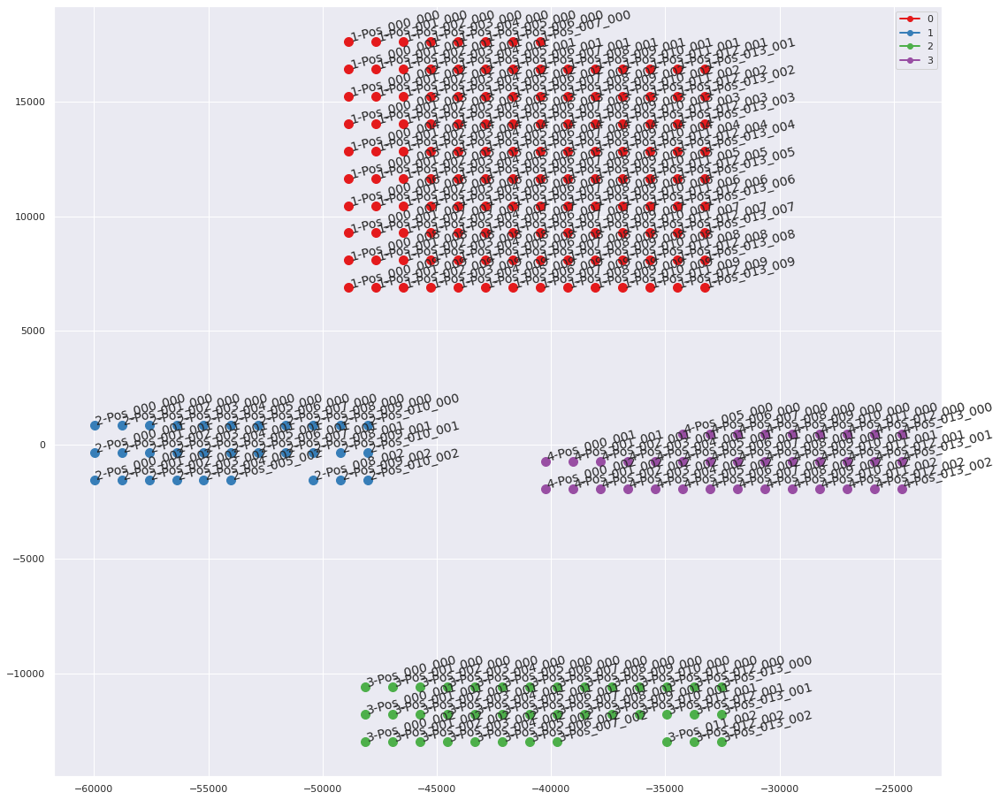

In [7]:
plot_positions(acq.cor_pos_df)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


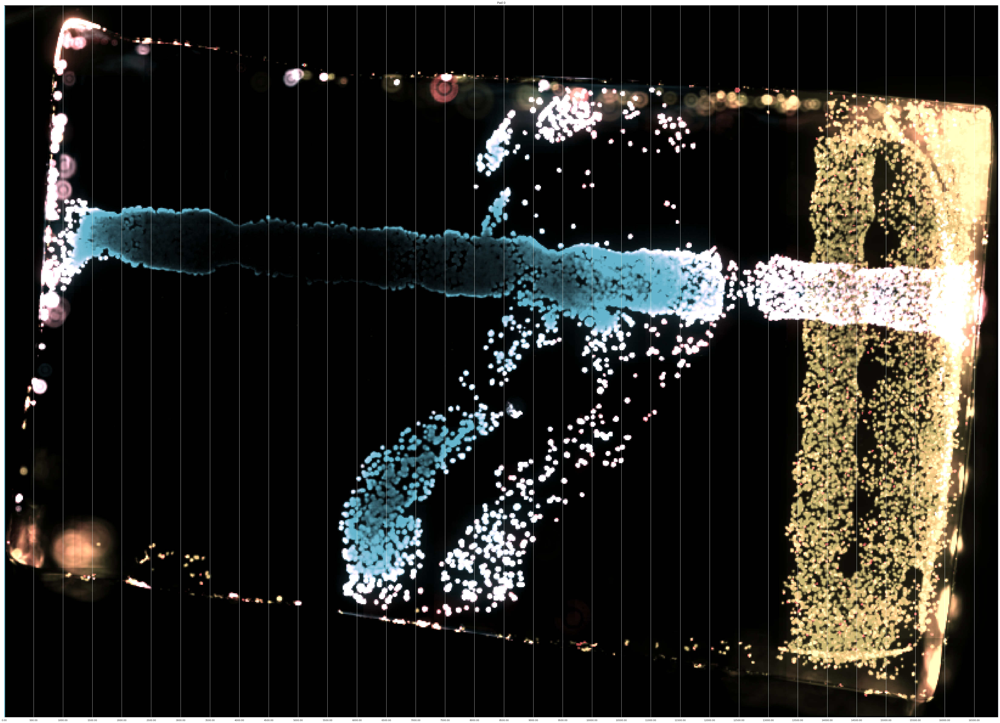

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


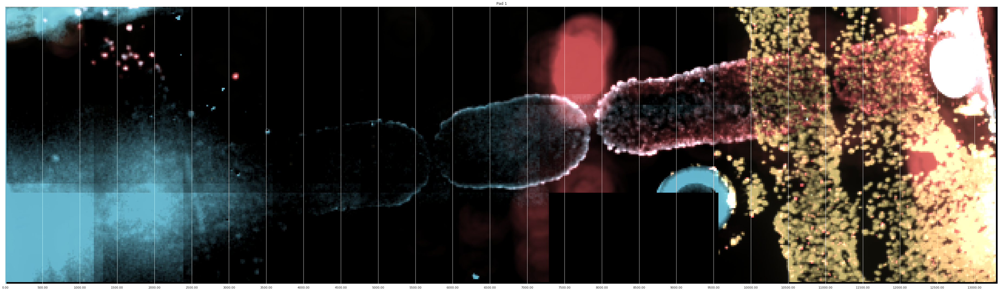

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


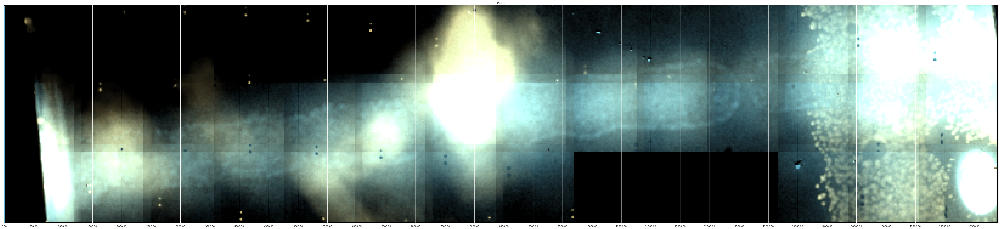

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


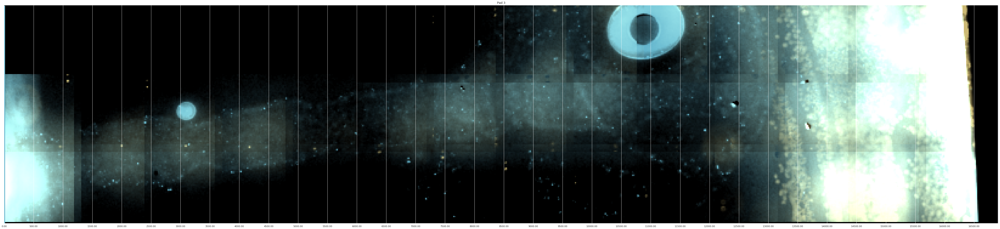

In [103]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
files_df, cor_pos_df, pixel_size = acq.files_df.copy(), acq.cor_pos_df.copy(), acq.pixel_size
pad_vec = np.unique(acq.files_df.pad.values)
xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,0,1,0,0,1,0,0,0,0,0,0,0]
frame=10
for pad in pad_vec:
#     try:
    out_fn = './anims/prog/191217_pad_{}.gif'.format(pad)
    fig = write_frame_w_bg(9, flip_vec[pad], xlims_vec[pad], pad, None, files_df, cor_pos_df, pixel_size, scale=8, rotation=acq.rotation)
    plt.show(fig)
#         fig, pad_arr = write_frame_no_bg(11, '', pad, acq.files_df,acq.cor_pos_df, acq.pixel_size, 1, 0)
#         plt.title(pad)
#         xlims = xlims_vec[pad]
#         plt.vlines(xlims[0], 0, pad_arr.shape[0],colors=['w'])
#         plt.vlines(xlims[1], 0, pad_arr.shape[0],colors=['w'])
#         plt.show(fig)
#     except Exception as e:
#         print(e)

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
files_df, cor_pos_df, pixel_size = acq.files_df.copy(), acq.cor_pos_df.copy(), acq.pixel_size
pad_vec = np.unique(acq.files_df.pad.values)
xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,0,1,0,0,1,0,0,0,0,0,0,0]
frame=10
for pad in pad_vec:
#     try:
    out_fn = './anims/prog/191217_pad_{}.gif'.format(pad)
    fig = write_frame_w_bg(9, flip_vec[pad], xlims_vec[pad], pad, None, files_df, cor_pos_df, pixel_size, scale=8, rotation=acq.rotation)
    plt.show(fig)
#         fig, pad_arr = write_frame_no_bg(11, '', pad, acq.files_df,acq.cor_pos_df, acq.pixel_size, 1, 0)
#         plt.title(pad)
#         xlims = xlims_vec[pad]
#         plt.vlines(xlims[0], 0, pad_arr.shape[0],colors=['w'])
#         plt.vlines(xlims[1], 0, pad_arr.shape[0],colors=['w'])
#         plt.show(fig)
#     except Exception as e:
#         print(e)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


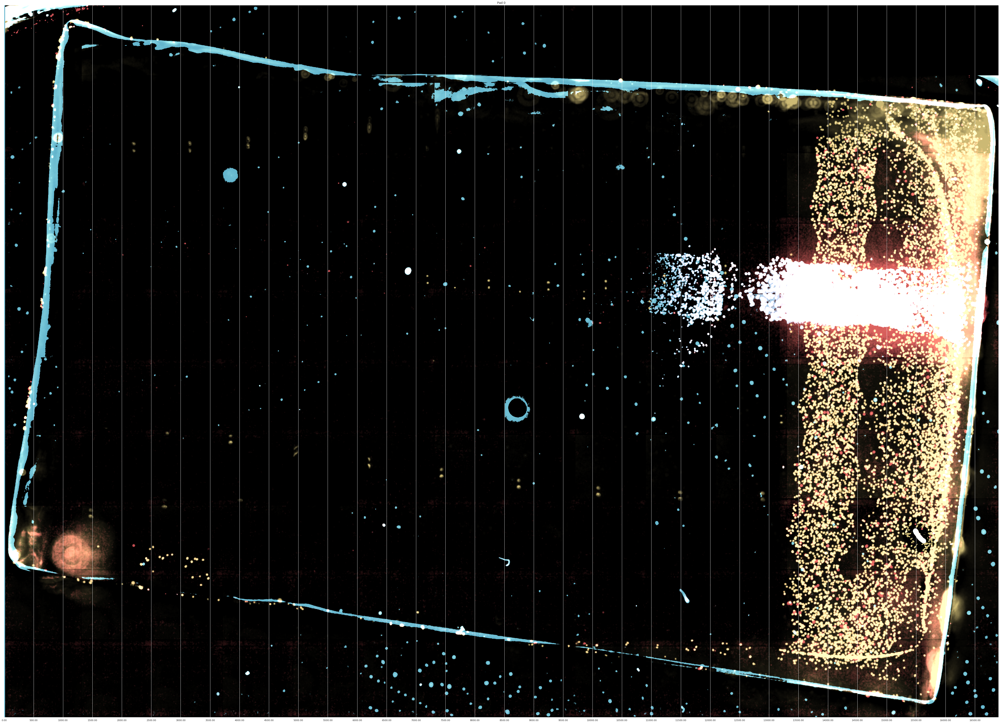

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


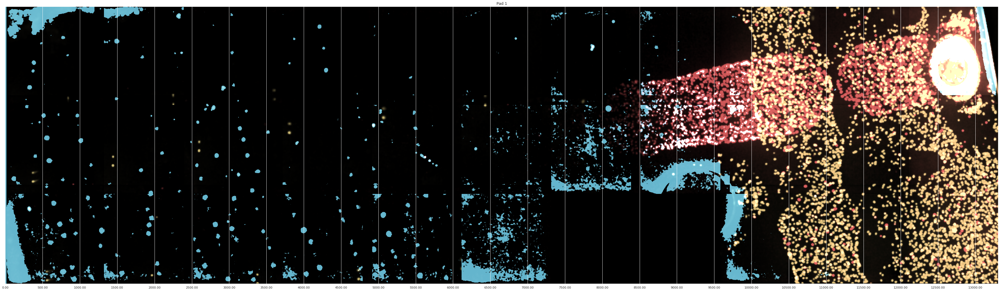

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


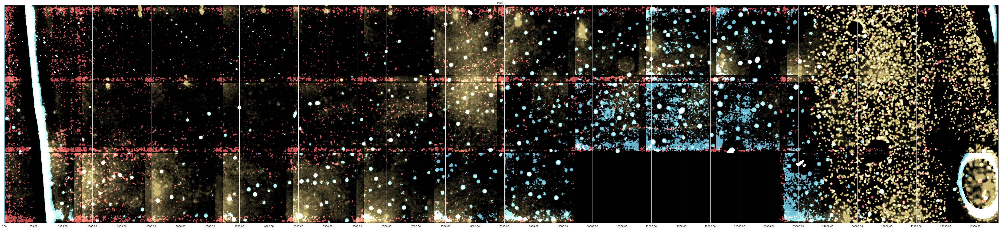

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


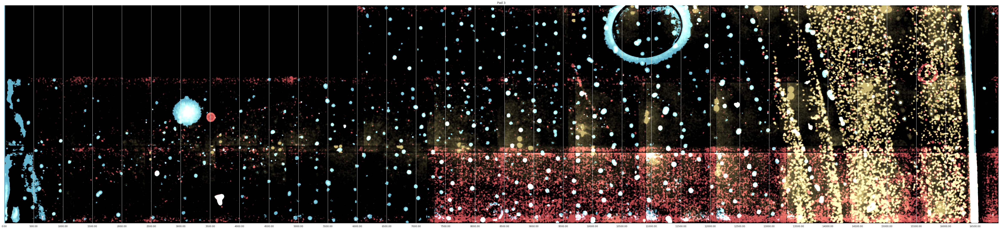

In [18]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
files_df, cor_pos_df, pixel_size = acq.files_df.copy(), acq.cor_pos_df.copy(), acq.pixel_size
pad_vec = np.unique(acq.files_df.pad.values)
xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,0,1,0,0,1,0,0,0,0,0,0,0]
frame=10
for pad in pad_vec:
#     try:
    out_fn = './anims/prog/191217_pad_{}.gif'.format(pad)
    fig = write_frame_no_bg(4, flip_vec[pad], xlims_vec[pad], pad, None, files_df, cor_pos_df, pixel_size, scale=1, rotation=acq.rotation)
    plt.show(fig)
#         fig, pad_arr = write_frame_no_bg(11, '', pad, acq.files_df,acq.cor_pos_df, acq.pixel_size, 1, 0)
#         plt.title(pad)
#         xlims = xlims_vec[pad]
#         plt.vlines(xlims[0], 0, pad_arr.shape[0],colors=['w'])
#         plt.vlines(xlims[1], 0, pad_arr.shape[0],colors=['w'])
#         plt.show(fig)
#     except Exception as e:
#         print(e)

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):

xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,1,0,0,1,0,0,0,0,0,0,0]
frame=10
for pad in np.arange(14):
#     try:
    out_fn = './anims/prog/pad_{}.gif'.format(pad)
    sub_fdf = files_df.loc[(files_df.frame>6)&(files_df.frame<13)]
    write_movie_no_bg(out_fn, flip_vec[pad], xlims_vec[pad], pad, cross_df, files_df, cor_pos_df, pixel_size, scale=1, rotation=0)
    print(out_fn)
#         fig, pad_arr = write_frame_no_bg(11, '', pad, acq.files_df,acq.cor_pos_df, acq.pixel_size, 1, 0)
#         plt.title(pad)
#         xlims = xlims_vec[pad]
#         plt.vlines(xlims[0], 0, pad_arr.shape[0],colors=['w'])
#         plt.vlines(xlims[1], 0, pad_arr.shape[0],colors=['w'])
#         plt.show(fig)
#     except Exception as e:
#         print(e)

./anims/prog/pad_0.gif


./anims/prog/pad_1.gif


In [867]:
cross_df

,frame,y,x,time,channel,pad,dxdt
0,5,-21969.00,1672.20,2.507221,3,0,0.00
1,6,-22506.68,1672.20,3.007221,3,0,82.72
2,6,-22382.60,1672.20,3.007221,3,0,82.72
3,6,-22217.16,1672.20,3.007221,3,0,0.00
4,6,-21969.00,1672.20,3.007221,3,0,413.60
...,...,...,...,...,...,...,...
3641,12,9100.62,3328.70,6.300504,3,13,NaN
3642,12,9141.98,3328.70,6.300504,3,13,NaN
3643,12,9183.34,2762.78,6.300504,3,13,NaN
3644,12,9224.70,2762.78,6.300504,3,13,NaN


In [16]:
writehelper = mma.WriteHelper(acq, scale=32, pad_ind=0, bg_option='pos_list')

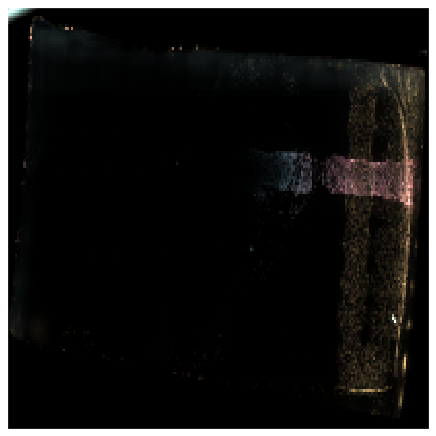

In [17]:
# writehelper._set_scale(16)
writehelper.setup_plot()
writehelper.animate(6)

In [9]:
procpad = mma.ProcessUnorderedDiff(acq, 0, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
procpad._load_arrs(False)
procpad1 = mma.ProcessUnorderedDiff(acq, 1, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
procpad1._load_arrs(False)

In [10]:
filt_arr = scipy.signal.savgol_filter(procpad.arr, 7,3, axis=0)

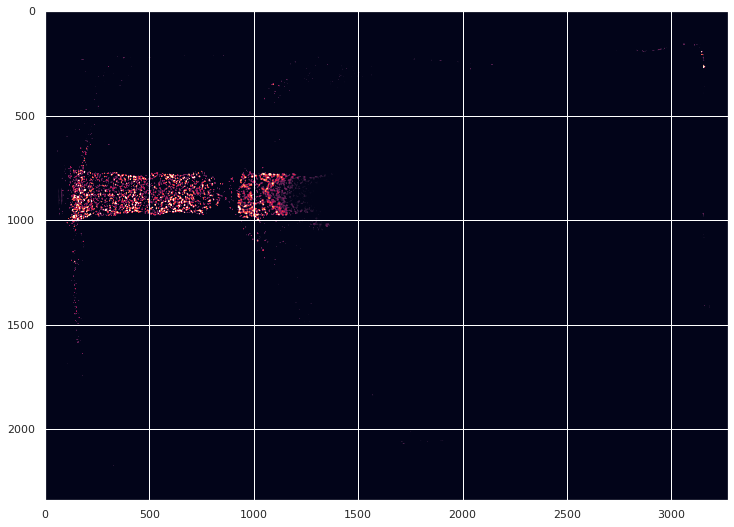

In [26]:
plt.figure(figsize=(14,9))
_ = plt.imshow(skimage.transform.rotate(filt_arr[5,2,:,:].copy(),3.8)[:,::-1],vmin=1e3,vmax=1e4)

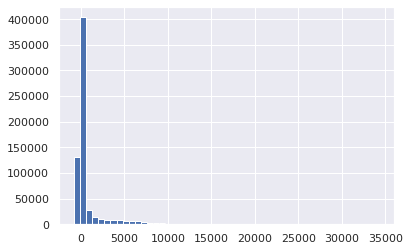

In [189]:
_ = plt.hist(skimage.transform.rotate(procpad.arr[7,1,:,:].copy(),3.8)[740:1000,3000:500:-1].flatten(),bins=50)

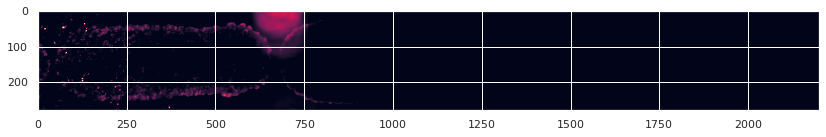

In [216]:
plt.figure(figsize=(14,9))
_ = plt.imshow(skimage.transform.rotate(procpad1.arr[9,1,:,:].copy(),-11)[220:500,2200:0:-1],vmin=1e3,vmax=1e4)

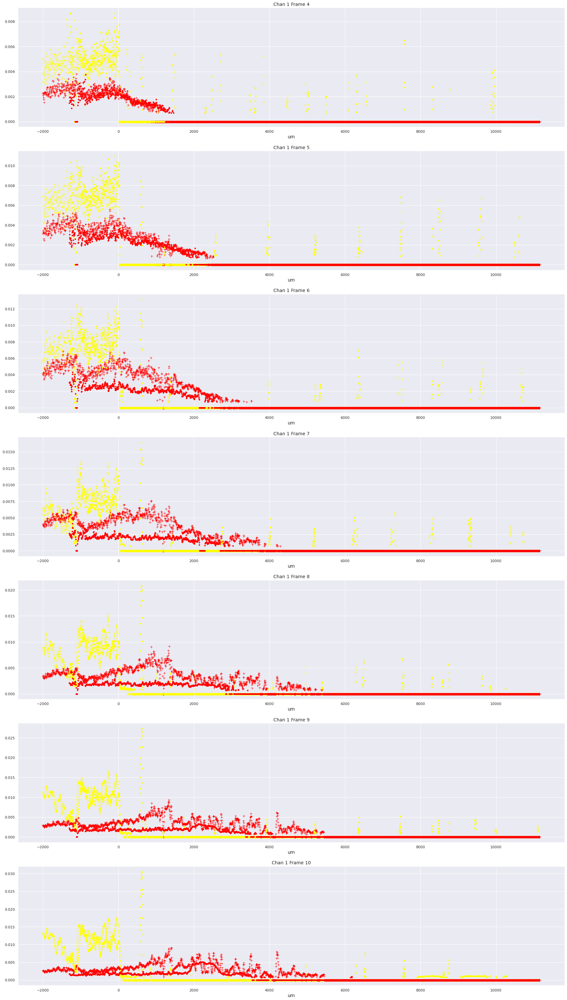

In [208]:
# import downsampled movie
pad_vals = [0,1]
pad_styles = ['+', '.']
offset_vals = [2e3, 1300]
np_slices = np.s_[740:1100,3000:500:-1], np.s_[220:500,2200:0:-1]
rot_vals = [3.8, -11]
chan_vals = [0,1]#,2]
col_vals = ['yellow','red','cyan']
max_vals = [1e4,1e4,3e4]
frame_vals = np.arange(4,11,1)
fig, axs = plt.subplots(len(frame_vals),1,figsize=(30,55))
for np_sl, x_off, ls, rot_val, pad_ind in zip(np_slices, offset_vals, pad_styles,rot_vals, pad_vals):
    procpad = mma.ProcessUnorderedDiff(acq, pad_ind, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
    procpad._load_arrs(False)
    for fi, frame_ind in enumerate(frame_vals):
        for max_val, c, chan_ind in zip(max_vals, col_vals, chan_vals):
            frame_img = procpad.arr[frame_ind, chan_ind, :, :].copy()
            frame_img = skimage.transform.rotate(frame_img, rot_val)[np_sl]
#             frame_img = skimage.filters.gaussian(frame_img, 8, preserve_range=True)
            bool_arr = frame_img>(max_val/10)
            frame_img[False==bool_arr] = 0
            plot_vec = frame_img.sum(axis=0) / (bool_arr.sum(axis=0)+1)
            plot_vec[plot_vec<=0] = 0
            plot_vec[bool_arr.sum(axis=0)<=1] = 0
            xvec = np.arange(len(plot_vec))
            plot_vec = 1e-2*plot_vec/max_val
            axs[fi].plot(2*1.6*1.646*xvec-x_off, plot_vec,c=c,linestyle='none',ms=7,marker=ls)
            axs[fi].set_title("Chan {} Frame {}".format(chan_ind, frame_ind))
#             axs[fi].set_ylim([0,1])
#             axs[fi].set_xlim([0,2.2e3])
            axs[fi].set_xlabel('um')


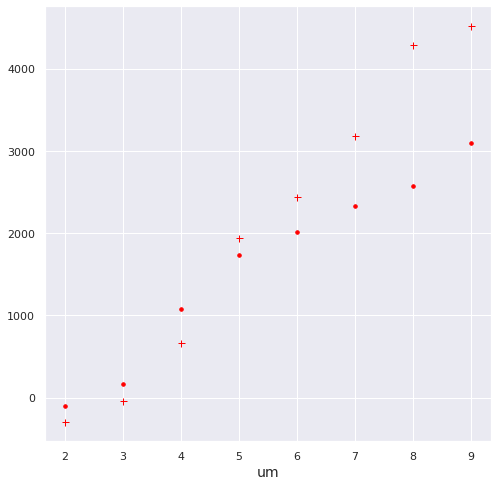

In [222]:
# import downsampled movie
pad_vals = [0,1]
pad_styles = ['+', '.']
offset_vals = [2e3, 1300]
np_slices = np.s_[740:1100,3000:500:-1], np.s_[220:500,2200:0:-1]
rot_vals = [3.8, -11]
chan_vals = [0,1]#,2]
col_vals = ['yellow','red','cyan']
max_vals = [1e4,1e4,3e4]
frame_vals = np.arange(2,10,1)
fig, axs = plt.subplots(1,1,figsize=(8,8))
for np_sl, x_off, ls, rot_val, pad_ind in zip(np_slices, offset_vals, pad_styles,rot_vals, pad_vals):
    procpad = mma.ProcessUnorderedDiff(acq, pad_ind, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
    procpad._load_arrs(False)
    for fi, frame_ind in enumerate(frame_vals):
        for max_val, c, chan_ind in zip(max_vals, col_vals, chan_vals):
            if chan_ind == 0:
                continue
            frame_img = procpad.arr[frame_ind, chan_ind, :, :].copy()
            frame_img = skimage.transform.rotate(frame_img, rot_val)[np_sl]
#             frame_img = skimage.filters.gaussian(frame_img, 8, preserve_range=True)
            bool_arr = frame_img>(max_val/10)
            frame_img[False==bool_arr] = 0
            plot_vec = frame_img.sum(axis=0) / (bool_arr.sum(axis=0)+1)
            plot_vec[plot_vec<=0] = 0
            plot_vec[bool_arr.sum(axis=0)<=1] = 0
            xvec = 2*1.6*1.646*np.arange(len(plot_vec))-x_off
            plot_vec = 1e-2*plot_vec/max_val
            axs.plot(frame_ind, np.quantile(xvec[plot_vec>0],0.9),c=c,linestyle='none',ms=7,marker=ls)
#             axs.set_title("Chan {} Frame {}".format(chan_ind, frame_ind))
#             axs[fi].set_ylim([0,1])
#             axs[fi].set_xlim([0,2.2e3])
            axs.set_xlabel('um')


In [10]:
exp_dirs[37]

'/groups/murray-biocircuits/jparkin/movies/191212_rpa_senders_again/img_1'

In [11]:
acq = mma.Acquisition(exp_dirs[37])
acq.bg_pos_list = [275,276,277,193,210,227,263]

In [87]:
procpad.pad_helper.one_arr.shape

(256, 256)

In [1]:
procpad.sigma

NameError: name 'procpad' is not defined

In [7]:
procpad = mma.ProcessUnorderedDiff(acq, 0, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
procpad._load_arrs(False)
procpad._setup_thresh(True)
# procpad1 = mma.ProcessUnorderedDiff(acq, 1, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
# procpad1._load_arrs(False)

KeyboardInterrupt: 

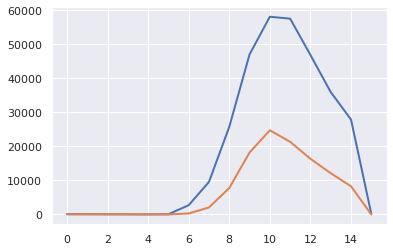

In [60]:
# plt.figure(figsize=(14,9))
_ = plt.plot(np.quantile(procpad.arr[:,2,1460:1500,1825:1875].copy(),0.99,axis=[1,2]))
_ = plt.plot(np.quantile(procpad.arr[:,1,1460:1500,1825:1875].copy(),0.99,axis=[1,2]))

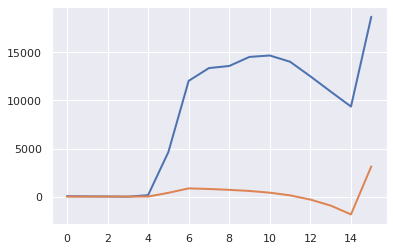

In [83]:
# plt.figure(figsize=(14,9))
_ = plt.plot(np.quantile(procpad.arr[:,2,840:870,2070:2150].copy(),0.99,axis=[1,2]))
_ = plt.plot(np.quantile(procpad.arr[:,1,840:870,2070:2150].copy(),0.99,axis=[1,2]))

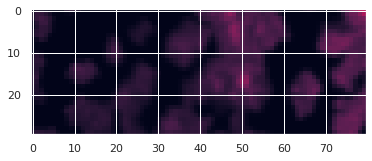

In [82]:
# plt.figure(figsize=(14,9))
_ = plt.imshow(procpad.arr[6,2,840:870,2070:2150],vmin=1e3,vmax=4e4)

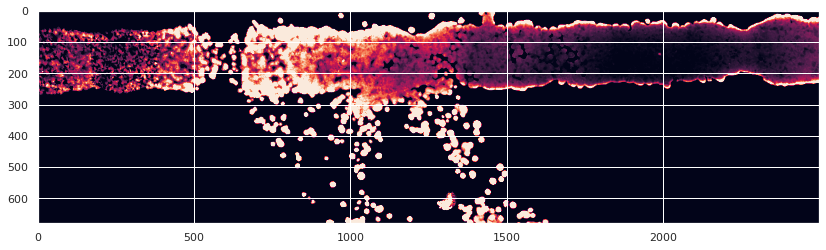

In [47]:
plt.figure(figsize=(14,9))
_ = plt.imshow(skimage.transform.rotate(procpad.arr[11,2,:,:].copy(),3.8)[720:1400,3000:500:-1],vmin=1e3,vmax=1e4)

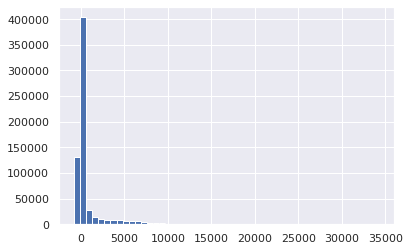

In [189]:
_ = plt.hist(skimage.transform.rotate(procpad.arr[7,1,:,:].copy(),3.8)[740:1000,3000:500:-1].flatten(),bins=50)

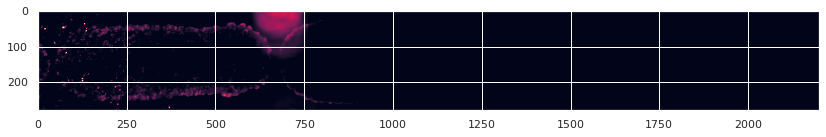

In [216]:
plt.figure(figsize=(14,9))
_ = plt.imshow(skimage.transform.rotate(procpad1.arr[9,1,:,:].copy(),-11)[220:500,2200:0:-1],vmin=1e3,vmax=1e4)

In [20]:
plt.vlines?

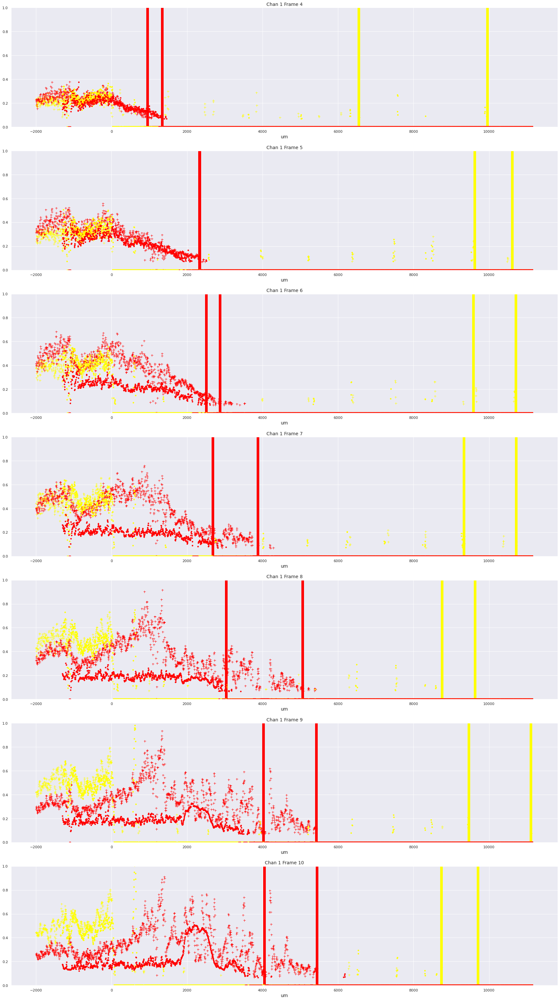

In [25]:
# import downsampled movie
pad_vals = [0,1]
pad_styles = ['+', '.']
offset_vals = [2e3, 1300]
np_slices = np.s_[740:1100,3000:500:-1], np.s_[220:500,2200:0:-1]
rot_vals = [3.8, -11]
chan_vals = [0,1]#,2]
col_vals = ['yellow','red','cyan']
max_vals = [3e4,1e4,3e4]
frame_vals = np.arange(4,11,1)
fig, axs = plt.subplots(len(frame_vals),1,figsize=(30,55))
for np_sl, x_off, ls, rot_val, pad_ind in zip(np_slices, offset_vals, pad_styles,rot_vals, pad_vals):
    procpad = mma.ProcessUnorderedDiff(acq, pad_ind, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
    procpad._load_arrs(False)
    for fi, frame_ind in enumerate(frame_vals):
        for max_val, c, chan_ind in zip(max_vals, col_vals, chan_vals):
            frame_img = procpad.arr[frame_ind, chan_ind, :, :].copy()
            frame_img = skimage.transform.rotate(frame_img, rot_val)[np_sl]
#             frame_img = skimage.filters.gaussian(frame_img, 8, preserve_range=True)
            bool_arr = frame_img>(max_val/10)
            frame_img[False==bool_arr] = 0
            plot_vec = frame_img.sum(axis=0) / (bool_arr.sum(axis=0)+1)
            plot_vec[plot_vec<=0] = 0
            plot_vec[bool_arr.sum(axis=0)<=1] = 0
            xvec = 2*1.6*1.646*np.arange(len(plot_vec))-x_off
            plot_vec = plot_vec/max_val
            axs[fi].plot(xvec, plot_vec,c=c,linestyle='none',ms=7,marker=ls)
            axs[fi].vlines([np.max(xvec[plot_vec>0.1])],0,1,color=c,lw=8)
            axs[fi].set_title("Chan {} Frame {}".format(chan_ind, frame_ind))
            axs[fi].set_ylim([0,1])
#             axs[fi].set_xlim([0,2.2e3])
            axs[fi].set_xlabel('um')


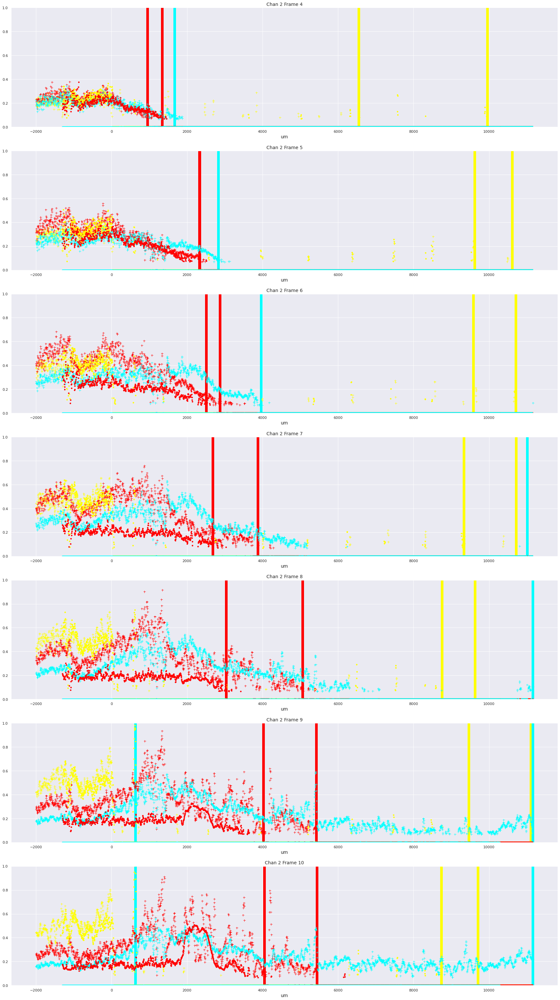

In [48]:
# import downsampled movie
pad_vals = [0,1]
pad_styles = ['+', '.']
offset_vals = [2e3, 1300]
np_slices = np.s_[740:1100,3000:500:-1], np.s_[220:500,2200:0:-1]
rot_vals = [3.8, -11]
chan_vals = [0,1,2]
col_vals = ['yellow','red','cyan']
max_vals = [3e4,1e4,3e4]
frame_vals = np.arange(4,11,1)
fig, axs = plt.subplots(len(frame_vals),1,figsize=(30,55))
for np_sl, x_off, ls, rot_val, pad_ind in zip(np_slices, offset_vals, pad_styles,rot_vals, pad_vals):
    procpad = mma.ProcessUnorderedDiff(acq, pad_ind, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
    procpad._load_arrs(False)
    for fi, frame_ind in enumerate(frame_vals):
        for max_val, c, chan_ind in zip(max_vals, col_vals, chan_vals):
            frame_img = procpad.arr[frame_ind, chan_ind, :, :].copy()
            frame_img = skimage.transform.rotate(frame_img, rot_val)[np_sl]
#             frame_img = skimage.filters.gaussian(frame_img, 8, preserve_range=True)
            bool_arr = frame_img>(max_val/10)
            frame_img[False==bool_arr] = 0
            plot_vec = frame_img.sum(axis=0) / (bool_arr.sum(axis=0)+1)
            plot_vec[plot_vec<=0] = 0
            plot_vec[bool_arr.sum(axis=0)<=1] = 0
            xvec = 2*1.6*1.646*np.arange(len(plot_vec))-x_off
            plot_vec = plot_vec/max_val
            axs[fi].plot(xvec, plot_vec,c=c,linestyle='none',ms=7,marker=ls)
            if np.any(plot_vec>0.1):
                axs[fi].vlines([np.max(xvec[plot_vec>0.1])],0,1,color=c,lw=8)
            axs[fi].set_title("Chan {} Frame {}".format(chan_ind, frame_ind))
            axs[fi].set_ylim([0,1])
#             axs[fi].set_xlim([0,2.2e3])
            axs[fi].set_xlabel('um')


In [12]:
acq.time_df

time
frame pad              
0     0        0.000000
      1      149.763617
      2      525.890665
      3     1084.625076
1     0     1419.518518
...                 ...
38    3    55211.597754
39    0    55549.629630
      1    55696.940087
      2    56074.968290
      3    56638.329994

[160 rows x 1 columns]

In [42]:
procpad.pad_helper.pixel_size

5.17

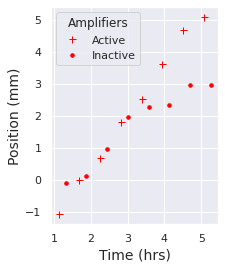

In [43]:
# import downsampled movie
pad_vals = [0,1]
pad_styles = ['+', '.']
offset_vals = [2e3, 1300]
np_slices = np.s_[740:1100,3000:500:-1], np.s_[220:500,2200:0:-1]
rot_vals = [3.8, -11]
chan_vals = [0,1]#,2]
col_vals = ['yellow','red','cyan']
max_vals = [1e4,1e4,3e4]
frame_vals = np.arange(2,10,1)
fig, axs = plt.subplots(1,1,figsize=(3,4))
handles = [0,0]
for np_sl, x_off, ls, rot_val, pad_ind in zip(np_slices, offset_vals, pad_styles,rot_vals, pad_vals):
    procpad = mma.ProcessUnorderedDiff(acq, pad_ind, 2, overwrite=False, bg_option='comb',sigma=1,bg_sigma=16)
    procpad._load_arrs(False)
    pixel_size = procpad.pad_helper.pixel_size
    for fi, frame_ind in enumerate(frame_vals):
        for max_val, c, chan_ind in zip(max_vals, col_vals, chan_vals):
            if chan_ind == 0:
                continue
            frame_img = procpad.arr[frame_ind, chan_ind, :, :].copy()
            frame_img = skimage.transform.rotate(frame_img, rot_val)[np_sl]
#             frame_img = skimage.filters.gaussian(frame_img, 8, preserve_range=True)
            bool_arr = frame_img>(max_val/10)
            frame_img[False==bool_arr] = 0
            plot_vec = frame_img.sum(axis=0) / (bool_arr.sum(axis=0)+1)
            plot_vec[plot_vec<=0] = 0
            plot_vec[bool_arr.sum(axis=0)<=1] = 0
            xvec = pixel_size*np.arange(len(plot_vec))-x_off
            plot_vec = plot_vec/max_val
            t_val = acq.time_df.loc[(frame_ind, pad_ind),'time']/3600
            h = axs.plot(t_val, np.max(xvec[plot_vec>0.15])/1e3,c=c,linestyle='none',ms=7,marker=ls)
            handles[pad_ind] = h[0]
#             axs.set_title("Chan {} Frame {}".format(chan_ind, frame_ind))
#             axs[fi].set_ylim([0,1])
#             axs[fi].set_xlim([0,2.2e3])
            axs.set_xlabel('Time (hrs)')
            axs.set_ylabel('Position (mm)')
axs.legend(handles=handles, labels=['Active','Inactive'],title='Amplifiers')

In [33]:
xvec[plot_vec>0.15]

array([-1078.24  , -1072.9728])

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):

xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,1,0,0,1,0,0,0,0,0,0,0]
cross_gb = cross_df.groupby(['pad','frame','channel'])
frame=8
for pad in np.arange(14):
#     try:
    fig, pad_arr = write_frame_no_bg(frame, '', pad, acq.files_df,acq.cor_pos_df, acq.pixel_size, 1, 0)
    plt.title(pad)
    xlims = xlims_vec[pad]
    plt.vlines(xlims[0], 0, pad_arr.shape[0],colors=['w'])
    plt.vlines(xlims[1], 0, pad_arr.shape[0],colors=['w'])
    key = (pad,frame,3)
    if key in cross_gb.groups.keys():
        rxval = cross_gb.get_group((pad,frame,3)).x.mean()/pixel_size
    else:
        rxval=0
    if flip_vec[pad]==1:
        rxval = xlims[1]-rxval
    else:
        rxval += xlims[0]
    key = (pad,frame,5)
    if key in cross_gb.groups.keys():
        cxval = cross_gb.get_group((pad,frame,5)).x.mean()/pixel_size
    else:
        cxval = 0
    if flip_vec[pad]==1:
        cxval = xlims[1]-cxval
    else:
        cxval = cxval+xlims[0]
    plt.vlines([rxval, cxval],[0,0],[pad_arr.shape[0],pad_arr.shape[0]],colors=['r','c'],lw=[15,15])
    plt.show(fig)
#     except Exception as e:
#         print(e)

In [ ]:

xlims_vec = [(100,3300),
         (400,3600),
         (450,3600),
         (500,3800),
         (50,3200),
         (300,3200),
         (300,3800),
         (400,3600),
         (400,4000),
         (800,4000),
         (450,3500),
         (400,3500),
         (400,4000),
         (900,4000)]
flip_vec = [0,0,0,1,0,0,1,0,0,0,0,0,0,0]

In [ ]:
plt.figure(figsize=(20,8))
sub_pad_arr = pad_arr
plt.imshow(pad_arr[:,:,2] > skimage.filters.threshold_li(pad_arr[:,:,2]))
# plt.plot(pad_arr[:,:,1].sum(axis=0))

In [ ]:
in_scale = 4
out_scale = 4
df_row = chan_df.iloc[-2303,:]
meta_cols = ['pad','pos','fn','frame','channel','time']
pad, pos, fn, frame, channel, im_time = df_row[meta_cols].values
py, px = cor_pos_df.loc[pos,['y', 'x']]

# Load imgs, bg subtract, threshold
im_arr = load_img(frame, pos, channel, scale=in_scale, sigma=3)
im_bg = load_img(0, pos, channel, scale=in_scale, sigma=15)
im_arr = im_arr - im_bg
im_arr[im_arr<0] = 0
im_bw = thresh_helper(im_arr)

data_cols = ['area', 'x','y','fluor']
columns = data_cols + meta_cols
if im_bw is None:
    print('nadda')
else:
    # downsample
    arr_dwn = skimage.transform.downscale_local_mean(im_arr, (out_scale, out_scale))
    bw_dwn = skimage.transform.downscale_local_mean(im_bw, (out_scale, out_scale))
    dwn_h, dwn_w = bw_dwn.shape

    # make df
    index = np.arange(dwn_h*dwn_w)
    df = pd.DataFrame(columns=columns,index=index)
    for meta_col in meta_cols:
        df.loc[:,meta_col] = df_row[meta_col]

    # fill in with downsampled x, y, fluor, cell area
    scaled_ps = pixel_size*in_scale*out_scale
    x, y = scaled_ps*np.mod(index, dwn_w)+px, scaled_ps*(index//dwn_w)+py
    df.loc[index,data_cols] = np.array([bw_dwn.flatten(), x, y, arr_dwn.flatten()]).T

In [ ]:
arr = df.pivot_table(index='y',columns='x',values='fluor').values
plt.imshow(arr_dwn)
# plt.colorbar()

In [ ]:
# def analyze_pads(pad_ind, files_df, cor_pos_df, pixel_size, in_scale=2, out_scale=8, rotation=180):
in_scale = 4
out_scale = 4
files_df, cor_pos_df, pixel_size = acq.files_df.copy(), acq.cor_pos_df.copy(), acq.pixel_size
rotation=acq.rotation

# Define helper functions
def load_img(frame, pos, channel, rotation=rotation, scale=in_scale, sigma=3, files_df=files_df):
    frame_bool = files_df.frame==frame
    pos_bool = files_df.pos==pos
    chan_bool = files_df.channel == channel
    indx_bool = (frame_bool)&(pos_bool)&(chan_bool)
    if sum(indx_bool) < 1:
        error_msg = 'Image not found frame:{} pos:{} channel:{}'
        error_msg = error_msg.format(frame, pos, channel)
        print(error_msg)
        return 0#skimage.transform.rotate(np.zeros((rh,rw)),rotation,resize=True)
    fn = files_df.loc[indx_bool,'fn'].values[0]
    try:
        img = skimage.filters.gaussian(skimage.io.imread(fn).astype(np.float), sigma)
    except Exception as error:
        print('import img error {}'.format(fn))
        raise error
    img = skimage.transform.downscale_local_mean(img, (scale, scale))
    return skimage.transform.rotate(img, rotation, resize=True)

def thresh_helper(im_arr):
    uint_max = 65535
    im_arr = im_arr / uint_max
    w, h = im_arr.shape
    # Smooth to reduce noise
    g_radius = 5
    im_smooth = skimage.filters.gaussian(im_arr, g_radius)
    im_smooth[im_smooth < 0] = 0

    thresh = skimage.filters.threshold_li(im_smooth)
    thresh = np.max([40/uint_max,thresh])
    im_bw = im_smooth > thresh
    if np.sum(im_bw) == 0 :
        return None
    return im_bw

def get_imgs(frame, pos, channel, in_scale, out_scale, in_sigma, out_sigma):
    # Load imgs, bg subtract, threshold
    im_arr = load_img(frame, pos, channel, scale=in_scale, sigma=in_sigma)
    im_bg = load_img(0, pos, channel, scale=in_scale, sigma=out_sigma)
    im_arr = im_arr - im_bg
    im_arr[im_arr<0] = 0
    im_bw = thresh_helper(im_arr)
    return im_arr, im_bg, im_bw

def process_img(df_row, cor_pos_df=cor_pos_df):
    meta_cols = ['pad','pos','fn','frame','channel','time']
    pad, pos, fn, frame, channel, im_time = df_row[meta_cols].values
    py, px = cor_pos_df.loc[pos,['y', 'x']]
    
    # Load imgs, bg subtract, threshold
    im_arr = load_img(frame, pos, channel, scale=in_scale, sigma=3)
    im_bg = load_img(0, pos, channel, scale=in_scale, sigma=15)
    im_arr = im_arr - im_bg
    im_arr[im_arr<0] = 0
    im_bw = thresh_helper(im_arr)
    
    data_cols = ['area', 'x','y','fluor']
    columns = data_cols + meta_cols
    if im_bw is None:
        return pd.DataFrame(columns=columns)
    # downsample
    arr_dwn = skimage.transform.downscale_local_mean(im_arr, (out_scale, out_scale))
    bw_dwn = skimage.transform.downscale_local_mean(im_bw, (out_scale, out_scale))
    dwn_h, dwn_w = bw_dwn.shape

    # make df
    index = np.arange(dwn_h*dwn_w)
    df = pd.DataFrame(columns=columns,index=index)
    for meta_col in meta_cols:
        df.loc[:,meta_col] = df_row[meta_col]

    # fill in with downsampled x, y, fluor, cell area
    scaled_ps = pixel_size*in_scale*out_scale
    x, y = scaled_ps*np.mod(index, dwn_w)+px, scaled_ps*(index//dwn_w)+py
    df.loc[index,data_cols] = np.array([bw_dwn.flatten(), x, y, arr_dwn.flatten()]).T
    return df

chan_df = files_df.loc[files_df.channel>0,:]
df = pd.concat([process_img(chan_df.loc[i,:], cor_pos_df) for i in chan_df.index], ignore_index=True)


In [9]:
df = pd.read_csv('191217_df.csv')

In [10]:
df.head()

,Unnamed: 0,area,x,y,fluor,pad,pos,fn,frame,channel,time
0,0,0.859375,-48851.57,-17656.81,799.856697,0,0.0,/groups/murray-biocircuits/jparkin/movies/1912...,0,2,1576642944
1,1,1.000000,-48810.21,-17656.81,1837.110653,0,0.0,/groups/murray-biocircuits/jparkin/movies/1912...,0,2,1576642944
2,2,1.000000,-48768.85,-17656.81,1508.605857,0,0.0,/groups/murray-biocircuits/jparkin/movies/1912...,0,2,1576642944
3,3,1.000000,-48727.49,-17656.81,937.284262,0,0.0,/groups/murray-biocircuits/jparkin/movies/1912...,0,2,1576642944
4,4,1.000000,-48686.13,-17656.81,918.697805,0,0.0,/groups/murray-biocircuits/jparkin/movies/1912...,0,2,1576642944


In [ ]:
gb_pad_frame_chan = df.groupby(['pad','frame','channel'])
arr = gb_pad_frame_chan.get_group((0,9,2)).pivot_table(index='x',columns='y',values='fluor')
arr[np.isnan(arr)]=0
plt.imshow(arr.T)

In [ ]:

def get_imgs(frame, pos, channel, in_scale, out_scale, in_sigma, out_sigma):
    # Load imgs, bg subtract, threshold
    im_arr = load_img(frame, pos, channel, scale=in_scale, sigma=in_sigma)
    im_bg = load_img(0, pos, channel, scale=in_scale, sigma=out_sigma)
    im_arr = im_arr - im_bg
    im_arr[im_arr<0] = 0
    im_bw = thresh_helper(im_arr)
    
    arr_dwn = skimage.transform.downscale_local_mean(im_arr, (out_scale, out_scale))
    bw_dwn = skimage.transform.downscale_local_mean(im_bw, (out_scale, out_scale))
    
    return arr_dwn, bw_dwn

frame, pos, channel = 14, 88, 5
in_scale, out_scale = 1, 16
in_sigma, out_sigma = 3, 30
im_arr, im_bw = get_imgs(frame, pos, channel, in_scale, out_scale, in_sigma, out_sigma)

In [ ]:
gb_pad_frame_channel = df.groupby(['pad','frame','channel'])
arr = gb_pad_frame_channel.get_group((1,6,5)).pivot_table(index='x',columns='y',values='fluor').values
arr[np.isnan(arr)]=0
plt.imshow(arr)
plt.xticks([])
plt.yticks([])

In [ ]:
df_row = chan_df.iloc[102,:]
meta_cols = ['pad','pos','fn','frame','channel','time']
pad, pos, fn, frame, channel, im_time = df_row[meta_cols].values
py, px = cor_pos_df.loc[pos,['y', 'x']]

# Load imgs, bg subtract, threshold
im_arr = load_img(frame, pos, channel, scale=in_scale, sigma=3)
im_bg = load_img(0, pos, channel, scale=in_scale, sigma=15)
im_arr = im_arr - im_bg
im_arr[im_arr<0] = 0
im_bw = thresh_helper(im_arr)

data_cols = ['area', 'x','y','fluor']
columns = data_cols + meta_cols
# if im_bw is None:
    
#     return pd.DataFrame(columns=columns)
# downsample
arr_dwn = skimage.transform.downscale_local_mean(im_arr, (out_scale, out_scale))
bw_dwn = skimage.transform.downscale_local_mean(im_bw, (out_scale, out_scale))
dwn_h, dwn_w = bw_dwn.shape

In [ ]:
repr_picklist = pd.read_csv('./190313_repr_picklist.csv')
repr_picklist = repr_picklist.loc[repr_picklist.exp_inds>=0,:]
repr_picklist = repr_picklist.sort_values(by=['iptg','ahl'])
gb_expind = repr_picklist[['iptg','ahl','exp_inds']].groupby('exp_inds')

In [ ]:
gb_frame_chan = df.groupby(['frame','channel'])#,'frame'])
fig, axs = plt.subplots(14,1,figsize=(8,50))
for chan in [5,3]:
    sub_df = gb_frame_chan.get_group((12,chan)).copy()
    sub_df['normed'] = 0.0
    tmp_df = sub_df[['x','pad','fluor','area']]#.groupby(['x','frame']).agg(np.median).reset_index()
    gb_pad = tmp_df.groupby('pad')
    for ax_ind, pad in enumerate(repr_picklist.exp_inds):
        iptg, ahl = gb_expind.get_group(pad)[['iptg', 'ahl']].values[0]
        x_binned = np.arange(0,1e4,1e2)
        x_bins = zip(x_binned,x_binned+1e2)
        flip = flip_vec[pad]
        plot_df = gb_pad.get_group(pad)
        bg_df = plot_df.loc[plot_df.area<4e-1,:]
        plot_df = plot_df.loc[plot_df.area>9e-1,:]
        arr = plot_df.fluor.values#.flatten().reshape((16,16))
        arr2 = plot_df.area.values#.flatten().reshape((16,16))
        y = (arr*(arr2>0.99))/(arr2+1e-3)
        sub_df.loc[plot_df.index,'normed'] = y
        xlims = np.array(xlims_vec[pad])*acq.pixel_size
        x = plot_df.x.values# - xlims.min()
        x = np.abs(x-[x.min(),x.max()][flip])-xlims[0]
        xlims = np.sort(np.abs(xlims-[x.min(),x.max()][flip]))
        y_binned = np.zeros_like(x_binned)
        axs[ax_ind].plot(x, y,'.')
        for i, bin_lims in enumerate(x_bins):
            x_l, x_r = bin_lims
            bool_vec = (x>=x_l)&(x<x_r)
            if np.sum(bool_vec)>1:
                y_binned[i] = np.median(y[bool_vec])
        axs[ax_ind].plot(x_binned, y_binned,'-k')
        axs[ax_ind].set_ylim([0,2e4])
        axs[ax_ind].set_xlim(xlims-xlims[0])
        axs[ax_ind].set_title("pad:{} iptg:{}mM ahl:{}uM".format(pad,iptg,ahl))
fig.tight_layout()

In [ ]:
gb_stuff = binned_df.groupby(['pad','chan','frame','y'])
indx = gb_stuff.groups.keys()
cross_df = pd.DataFrame(index=indx, columns=['pad','chan','frame','y','xcross'])
for key, sub_df in gb_stuff:
    athresh = sub_df.nf > 3e3
    if np.sum(athresh.values):
        xval = np.nan
    else:
        xval = sub_df.loc[athresh,'x'].max()
    pad,chan,frame,yval = key
    cross_df.loc[key,:] = pad,chan,frame,yval,xval

In [ ]:
plt.imshow(f_arr)
_ = plt.xticks(np.arange(0,250,50),x_vec[np.arange(0,250,50)]//1)
# plt.xticklabels(x_vec[np.arange(0,250,50)])

In [ ]:
for frame in np.arange(20):
    tmp_df = occ_df.groupby(['pad','channel','frame']).get_group((2,5,frame))
    tmp_df = tmp_df[['area','fluor','x','y']].groupby(['x','y']).agg(np.mean).reset_index()
    arr_df = tmp_df.pivot(index='x',columns='y',values='area')
    x_vec = arr_df.index.values.copy()
#     x_vec = x_vec.max() - x_vec
    a_arr = tmp_df.pivot(index='x',columns='y',values='area').values.T
    f_arr = tmp_df.pivot(index='x',columns='y',values='fluor').values.T
    n_arr = f_arr/(a_arr+(a_arr==0))
    n_arr[a_arr<9.9e-2] = 0
    athresh = n_arr>2e3
    h, w = f_arr.shape
    for hi in np.arange(h):
        if np.any(athresh[hi,:]):
            _ = plt.plot(frame, np.max(x_vec[athresh[hi,:]]),'k.')

In [ ]:
key = (3,5)
sub_df = gb_pad.get_group(key)
pad, chan = key
avgd_df = sub_df[['area','fluor','x','y','time','frame']].groupby(['x','y','frame']).agg(np.mean).reset_index()
time_df = avgd_df[['frame','time']].groupby('frame').agg(np.mean)
area_v = avgd_df.area.values
fluor_v = avgd_df.fluor.values
normed_v = fluor_v / (area_v+(area_v==0))
normed_v[area_v>0.95]=0
threshed_v = normed_v > 1e4
plot_df = avgd_df.loc[threshed_v,['frame','y','x']].groupby(['frame','y']).agg(np.max).reset_index()

In [ ]:
occ_df = df.copy()
gb_pad = occ_df.groupby('pad')
for key, sub_df in gb_pad:
    flip = flip_vec[key]
    xlims = np.array(xlims_vec[key])*pixel_size
    x = sub_df['x'].values
    occ_df.loc[sub_df.index,'x'] = np.abs(x-[x.min(),x.max()][flip])-xlims[0]
    
occ_df.loc[:,'time'] = occ_df.loc[:,'time'] - occ_df.time.min()

In [ ]:
np.unique(files_df.channel.values)

In [ ]:
fig, axs = plt.subplots(14,2,figsize=(12,40))
# gb_pad = agg_df.reset_index().groupby(['pad','channel','y'])


bool_vec = (occ_df.x<7.5e3)&(occ_df.x>0)&(occ_df.frame<13)
# athresh = occ_df.normed>2e3
# occ_vec = occ_df.area>0.0099
thresh_dict = {2:5e3,3:2.5e3,5:2.5e3}
occ_df['time'] = occ_df.time.values.astype(np.float)
occ_df['frame'] = occ_df.frame.values.astype(np.int)
gb_pad = occ_df.loc[bool_vec,:].groupby(['pad','channel'])#,'y','frame'])
out_df_list = []
for key, sub_df in gb_pad:
    # Rearrange
    pad, chan = key
    sub_cols = ['area','fluor','x','y','time','frame']
    gb_cols = ['x','y','frame']
    avgd_df = sub_df[sub_cols].groupby(gb_cols).agg(np.mean).reset_index()
    time_df = avgd_df[['frame','time']].groupby('frame').agg(np.mean)
    time_df['time'] = time_df['time']/3600
    
    # Threshold
    area_v = avgd_df.area.values
    fluor_v = avgd_df.fluor.values - avgd_df.loc[area_v<0.1,'fluor'].mean()
    normed_v = fluor_v / (area_v+(area_v==0))
    normed_v[area_v<0.99]=0
    threshed_v = normed_v > thresh_dict[chan]
    plot_df = avgd_df.loc[threshed_v,['frame','y','x']].groupby(['frame','y']).agg(np.max).reset_index()
    
    ax = axs[pad,chan//4]
    if not np.all(plot_df.frame>7):
        f_vec = plot_df.frame.values
        t_vec = time_df.loc[f_vec,'time'].values
        plot_df['time'] = t_vec
        plot_df['channel'] = chan
        plot_df['pad'] = pad
        out_df_list.append(plot_df)
        ax.plot(t_vec, plot_df.x.values, 'k.',alpha=0.3,ms=8)
        med_df = plot_df.groupby('frame').agg(np.mean).reset_index().sort_values(by='frame')
        f_vec = med_df.frame.values
        t_vec = time_df.loc[f_vec,'time'].values
        ax.plot(t_vec, med_df.x.values, 'r-')
    ax.set_title('pad:{} chan:{}'.format(pad,chan))
    ax.set_xlim([0,1.1*time_df.time.max()])
    ax.set_ylim([0,8e3])

fig.tight_layout()

In [ ]:
cross_df = pd.concat(out_df_list,ignore_index=True)

In [ ]:
cross_df['dxdt'] = np.nan
gb_ypad = cross_df.groupby(['y','pad','channel'])
for key, sub_df in gb_ypad:
    y, pad, chan = key
    sub_df = sub_df.sort_values(by='time')
    t_vec, x_vec = sub_df.time, sub_df.x
    dxdt_v = np.diff(x_vec)/np.diff(t_vec)
    cross_df.loc[sub_df.index[:-1],'dxdt'] = dxdt_v

In [ ]:
metadata = repr_picklist.groupby('exp_inds')
ahl_concs = np.unique(repr_picklist.ahl.values)
n_ahl = len(ahl_concs)
ahl_ticks = dict(zip(ahl_concs, np.arange(n_ahl)))
iptg_concs = np.unique(repr_picklist.iptg.values)
n_iptg = len(iptg_concs)
iptg_ticks = dict(zip(iptg_concs, np.arange(n_iptg)))

In [ ]:
metadata.get_group(pad)[['iptg', 'ahl']].values

In [ ]:
gb_padchan = cross_df.loc[np.isfinite(cross_df.dxdt),:].groupby(['pad','channel'])
fig, axs = plt.subplots(len(ahl_concs),2,figsize=(12,7))
for key, sub_df in gb_padchan:
    pad, chan = key
    iptg, ahl = metadata.get_group(pad)[['iptg', 'ahl']].values[0]
    iptg_tick = iptg_ticks[iptg]
    ahl_tick = ahl_ticks[ahl]
    agg_df = sub_df.groupby('time').agg(np.mean).reset_index()
    ax = axs[ahl_tick, chan//4]
    ax.plot(iptg_tick, agg_df.dxdt.mean(),'k.',ms=18)
    ax.set_xticks(np.arange(n_iptg))
    ax.set_xticklabels(iptg_concs)
    ax.set_title('AHL: {}uM'.format(ahl))
    ax.set_xlim([-1,n_iptg])
    ax.set_ylim([100,1500])
fig.tight_layout()

In [ ]:
plt.plot(repr_picklist.ahl, repr_picklist.iptg, '.')

In [ ]:
gb_padchan = cross_df.loc[np.isfinite(cross_df.dxdt),:].groupby(['pad','channel'])
fig, axs = plt.subplots(len(ahl_concs),2,figsize=(8,12))
for key, sub_df in gb_padchan:
    pad, chan = key
    iptg, ahl = metadata.get_group(pad)[['iptg', 'ahl']].values[0]
    iptg_tick = iptg_ticks[iptg]
    ahl_tick = ahl_ticks[ahl]
    agg_df = sub_df.groupby('time').agg(np.mean).reset_index()
    ax = axs[ahl_tick, chan//4]
    ax.plot(iptg_tick, agg_df.dxdt.mean(),'k.',ms=18)
    ax.set_xticks(np.arange(n_iptg))
    ax.set_xticklabels(iptg_concs)
    ax.set_title('AHL: {}uM Chan: {}'.format(ahl, chan))
    ax.set_xlim([-1,n_iptg])
    ax.set_ylim([100,1500])
for i in np.arange(n_ahl):
    axs[i,0].set_ylabel('Mean wave velocity')
for i in np.arange(2):
    axs[-1,i].set_xlabel('IPTG mM')
fig.tight_layout()

In [ ]:
iptg_tick

In [ ]:
gb_padchan = cross_df.loc[np.isfinite(cross_df.dxdt),:].groupby(['pad','channel'])
fig, axs = plt.subplots(len(ahl_concs),2,figsize=(8,12))
for key, sub_df in gb_padchan:
    pad, chan = key
    iptg, ahl = metadata.get_group(pad)[['iptg', 'ahl']].values[0]
    iptg_tick = iptg_ticks[iptg]
    ahl_tick = ahl_ticks[ahl]
    agg_df = sub_df.groupby('time').agg(np.mean).reset_index()
    ax = axs[ahl_tick, chan//4]
    ax.plot(iptg_tick, agg_df.x.max(),'k.',ms=18)
    ax.set_xticks(np.arange(n_iptg))
    ax.set_xticklabels(iptg_concs)
    ax.set_title('AHL: {}uM Chan: {}'.format(ahl, chan))
    ax.set_xlim([-1,n_iptg])
    ax.set_ylim([cross_df.x.min()*0.9,cross_df.x.max()*1.1])
for i in np.arange(n_ahl):
    axs[i,0].set_ylabel('Max dist')
for i in np.arange(2):
    axs[-1,i].set_xlabel('IPTG mM')
fig.tight_layout()

In [ ]:
key = (8,3)
sub_df = gb_pad.get_group(key)
# Rearrange
pad, chan = key
sub_cols = ['area','fluor','x','y','time','frame']
gb_cols = ['x','y','frame']
avgd_df = sub_df[sub_cols].groupby(gb_cols).agg(np.mean).reset_index()
time_df = avgd_df[['frame','time']].groupby('frame').agg(np.mean)
time_df['time'] = time_df['time']/3600

# Threshold
area_v = avgd_df.area.values
fluor_v = avgd_df.fluor.values# - avgd_df.loc[area_v<0.9,'fluor'].mean()
normed_v = fluor_v / (area_v+(area_v==0))
normed_v[area_v<0.9]=0
threshed_v = normed_v > thresh_dict[chan]
plot_df = avgd_df.loc[threshed_v,['frame','y','x']].groupby(['frame','y']).agg(np.max).reset_index()

In [ ]:
avgd_df['fluor'] = fluor_v
gb_frame = avgd_df.groupby('frame')
frame = 8
f_arr = gb_frame.get_group(frame).pivot_table(index='x',columns='y',values='fluor',aggfunc=np.median)
a_arr = gb_frame.get_group(frame).pivot_table(index='x',columns='y',values='area',aggfunc=np.median)
n_arr = f_arr/(a_arr+(a_arr==0))
n_arr[a_arr<0.1]=0
plt.figure(figsize=(20,4))
plt.imshow(n_arr.T)

In [ ]:
gb_pad = cross_df.groupby(['pad','chan','y'])
fig, axs = plt.subplots(14,2,figsize=(8,40))
for key, sub_df in gb_pad:
    pad, chan, yval = key
    axs[pad,chan//4].plot(sub_df.frame, sub_df.xcross, '.')
    axs[pad,chan//4].set_title(key)
    axs[pad,chan//4].set_xlim([0,20])
fig.tight_layout()

In [ ]:
gb_pad_chan_frame = df.groupby(['pad','channel','frame'])
for frame in [5,7,9,11,13]:
    sub_df = gb_pad_chan_frame.get_group((11,5,frame))
    tmp_df = sub_df.loc[sub_df.area>1e-1,:].copy()
    arr = tmp_df.fluor.values#.flatten().reshape((16,16))
    arr2 = tmp_df.area.values#.flatten().reshape((16,16))
    tmp_df.loc[:,'normed'] = (arr*(arr2>1e-1))/(arr2+1e-3)
    thresh = 5e3
    athresh = tmp_df.loc[tmp_df.normed>thresh]
    acount = athresh[['x','normed']].groupby('x').agg(len)
    allcount = tmp_df[['x','normed']].groupby('x').agg(len)
    plt.plot(acount.index, acount.normed/allcount.loc[acount.index,'normed'],'-')
# plt.plot(bcount.x, bcount.normed/16,'.')

In [ ]:
gb_pad_chan_frame = df.groupby(['pad','channel','frame'])
for frame in [5,7,9,11,13]:
    sub_df = gb_pad_chan_frame.get_group((11,3,frame))
    tmp_df = sub_df.loc[sub_df.area>1e-1,:].copy()
    arr = tmp_df.fluor.values#.flatten().reshape((16,16))
    arr2 = tmp_df.area.values#.flatten().reshape((16,16))
    tmp_df.loc[:,'normed'] = (arr*(arr2>1e-1))/(arr2+1e-3)
    thresh = 5e3
    athresh = tmp_df.loc[tmp_df.normed>thresh]
    acount = athresh[['x','normed']].groupby('x').agg(len)
    allcount = tmp_df[['x','normed']].groupby('x').agg(len)
    plt.plot(acount.index, acount.normed/allcount.loc[acount.index,'normed'],'-')
# plt.plot(bcount.x, bcount.normed/16,'.')

In [ ]:
def val_order(col, frac_indx=0.5):
    col = np.sort(col)
    n = len(col)
    ind = np.int(n*frac_indx)
    return col[ind]

gb_frame = df.groupby('frame')
for frame in [6,9]:
    sub_df = gb_frame.get_group(frame).copy()
    sub_df = sub_df.loc[sub_df.area>1e-1,:]
    sub_df['normed'] = (sub_df.fluor/sub_df.area)#*(sub_df.area>1e-1)
    gb_x = sub_df[['x','normed']].groupby('x')
    min_f = lambda x : val_order(x, frac_indx=0.05)
    max_f = lambda x : val_order(x, frac_indx=0.95)
    sub_min = gb_x.agg(min_f).reset_index()
    sub_med = gb_x.agg(np.median).reset_index()
    sub_max = gb_x.agg(max_f).reset_index()
    plt.plot(sub_min.x, sub_min.normed,'--k')
    plt.plot(sub_med.x, sub_med.normed,'-b')
    plt.plot(sub_max.x, sub_max.normed,'--r')

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
angle = np.linspace(-4,-2,10)[0]
fig, pad_arr = write_all_frame_no_bg(19, '', acq.files_df,acq.cor_pos_df, acq.pixel_size, 64, 0)
fig.savefig('tmp.png')
plt.close('all')
print('done')

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
angle = np.linspace(-4,-2,10)[0]
fig = write_frame_no_bg(22, '', 2, acq.files_df,acq.cor_pos_df, acq.pixel_size, 8, 3.4275)

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
angle = np.linspace(-4,-2,10)[0]
fig = write_frame_no_bg(22, '', 1, acq.files_df,acq.cor_pos_df, acq.pixel_size, 8, 3.4275)

In [ ]:
# write_frame_no_bg(frame_ind, out_fn, pad_ind, files_df, cor_pos_df, pixel_size, scale=4, rotation=180):
cpdf = acq.cor_pos_df.copy()
cpdf_gb = cpdf.groupby('label')
pos_list = acq.cor_pos_df.loc[bg_pos_list,'label'][:3]#['Pos0']#, 'Pos19', 'Pos20', 'Pos21', 'Pos22', 'Pos23']
sub_cpdf = pd.concat([cpdf_gb.get_group(xx) for xx in pos_list])
fdf_gb = acq.files_df.groupby('posname')
sub_fdf = pd.concat([fdf_gb.get_group(xx) for xx in pos_list])
angle = np.linspace(-4,-2,10)[0]
for pos in pos_list:
    fig = write_all_frame_no_bg(10, '', acq.files_df, cpdf_gb.get_group(pos), acq.pixel_size, 2, 0)
    plt.show(fig)

In [ ]:
bg_pos_list

In [ ]:
acq.cor_pos_df.index = np.array([np.int(xx[3:]) for xx in acq.cor_pos_df.label.values])

In [ ]:
min_ind = 40
acq_list = []
for i, fn in enumerate(exp_dirs[min_ind:min_ind+1]):
    acq = mma.Acquisition(fn, False, False, False)
    acq.cor_pos_df.sort_values(by='label', inplace=True)
    acq_list.append(acq)
#     acq.write_all_pad_frame_no_bg()
#     acq = mma.Acquisition(fn, True, True, False)
    plot_positions(acq.cor_pos_df)
    plt.title(fn + " ind: {}".format(i) )

In [ ]:
acq.cor_pos_df.index = np.array([np.int(xx[3:]) for xx in acq.cor_pos_df.label.values])
pad_ind_lists = [np.arange(9),np.arange(9,14),np.arange(14,22),np.arange(22,34),
                 np.arange(34,44),np.arange(44,56)]
fdf_gb_posname = acq.files_df.groupby('posname')
for i, pad_inds in enumerate(pad_ind_lists):
    acq.cor_pos_df.loc[pad_inds,'pad']=i
    labels = acq.cor_pos_df.loc[pad_inds,'label'].values
    for label in labels:
        indx = fdf_gb_posname.get_group(label).index
        acq.files_df.loc[indx, 'pad'] = i
acq.cor_pos_df.to_csv(acq.cor_pos_df_fn)
acq.files_df.to_csv(acq.files_df_fn)

In [ ]:
plot_positions(acq.cor_pos_df)

In [ ]:
# acq.cor_pos_df.index = np.array([np.int(xx[3:]) for xx in acq.cor_pos_df.label.values])
# pad_ind_lists = [np.arange(9),np.arange(9,14),np.arange(14,22),np.arange(22,34),
#                  np.arange(34,44),np.arange(44,56)]
cpd_gb_posname = acq_list[0].cor_pos_df.groupby('label')
fdf_gb_posname = acq_list[1].files_df.groupby('posname')
cpd1_gb_posname = acq_list[1].cor_pos_df.groupby('label')
for label, sub_df in cpd_gb_posname:
    acq.cor_pos_df.loc[cpd1_gb_posname.get_group(label).index, 'pad'] = cpd_gb_posname.get_group(label).pad.values[0]
    indx = fdf_gb_posname.get_group(label).index
    acq.files_df.loc[indx, 'pad'] = i
acq.cor_pos_df.to_csv(acq.cor_pos_df_fn)
acq.files_df.to_csv(acq.files_df_fn)

In [ ]:
acq.cor_pos_df.to_csv(acq.cor_pos_df_fn)
acq.files_df.to_csv(acq.files_df_fn)

In [ ]:
plt.plot(acq.cor_pos_df.x, acq.cor_pos_df.y,'.')

In [ ]:
acq.write_frame_no_bg(0,0,32)

In [ ]:
min_ind = 0
data_list = []
for i, fn in enumerate(exp_dirs[min_ind:]):
    acq = mma.Acquisition(fn, False, False, False)
    im_len = acq.pixel_size * acq.im_width
    row_list = [acq.super_dir, acq.chan_names, acq.objective, acq.rotation, acq.magoption16, im_len]
    data_list.append(row_list)

In [ ]:
obj_metadata = np.array(data_list)

In [ ]:
obj_df = pd.DataFrame(obj_metadata,columns=['superdir', 'chans', 'obj', 'rot', 'mag', 'im_len'])

In [ ]:
5,4,2,1,0
10,10,100,60,100

In [ ]:
for row in obj_df[['superdir','obj','rot','mag','im_len']].values:
    print(row)